In [1]:
import logging
gpd_logger = logging.getLogger('geopandas')
gpd_logger.setLevel(logging.WARNING)
mpl_logger = logging.getLogger('matplotlib')
mpl_logger.setLevel(logging.WARNING)
fi_logger = logging.getLogger('fiona')
fi_logger.setLevel(logging.WARNING)
import pandas as pd
import geopandas as gpd
import shapefile
import plotly.offline as po
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
import xarray as xr
import xsimlab as xs
import seaborn as sns
import matplotlib.pyplot as plt
import multiprocessing as mp
from datetime import datetime
import sys
sys.path.append('..')
from src.epivislab import spatial_simulation, make_burden_plot

In [2]:
sim_data = xr.open_zarr('/Users/kpierce/episimlab/results/DemoATX_78712_start_with_incidence.zarr/')

The `sim_data` xarray has the following coordinates:

- `age_group` is one of five age bins
- `risk_group` is one of two risk categories
- `compartment` is the compartment of the model
    - prevalence compartments in this model version are S, E, Pa, Py, Ia, Iy, Ih, R and D
    - incidence compartments in this model are E2P, E2Py, P2I, Pa2Ia, Py2Iy, Iy2Ih, H2D
    - S = susceptible, E = exposed, P = pre-infectious, I = infectious, R = recovered, D = deceased
    - a = asymptomatic, y = symptomatic, h = hospitalized
- `vertex` is the spatial axis of the array; the "home" location in the contact matrix (e.g. ZCTA or CBG)
- `step` is the temporal axis of the array; is the time step in the model

In [3]:
sim_data

<xarray.Dataset>
Dimensions:                          (age_group: 5, compartment: 16, risk_group: 2, step: 195, vertex: 87)
Coordinates:
  * age_group                        (age_group) object '18-49' '5-17' ... '<5'
  * compartment                      (compartment) object 'S' 'E' ... 'H2D'
  * risk_group                       (risk_group) object 'low' 'high'
  * step                             (step) datetime64[ns] 2020-03-11 ... 202...
  * vertex                           (vertex) float64 7.651e+04 ... 7.896e+04
Data variables:
    apply_counts_delta__counts       (step, vertex, age_group, risk_group, compartment) float64 dask.array<chunksize=(98, 44, 3, 1, 8), meta=np.ndarray>
    foi__beta                        float64 ...
    get_contact_xr__contacts_fp      <U50 ...
    get_contact_xr__travel_fp        <U61 ...
    read_config__config_fp           <U45 ...
    setup_counts__census_counts_csv  <U61 ...
    setup_counts__initial_ia         int64 ...
    setup_counts__initial_vertex     int64 ...

Additional data to define the ZCTA shapes, needed for mapping.

In [4]:
atx_zcta = gpd.read_file('/Users/kpierce/COVID19/austin-spatial-prev/central_tx_zcta_2019.shp')

Get the total number of infectious people (`Ia+Iy`) and merge with the ZCTA shapefile.

In [5]:
sim_arr = sim_data['apply_counts_delta__counts']
sympt_inf = spatial_simulation(sim_arr, atx_zcta, 'Iy')
asymp_inf = spatial_simulation(sim_arr, atx_zcta, 'Ia')
sympt_inf = pd.merge(sympt_inf, asymp_inf, on=['step', 'vertex', 'lon', 'lat', 'date'])
sympt_inf['apply_counts_delta__counts'] = sympt_inf['apply_counts_delta__counts_x'] + sympt_inf['apply_counts_delta__counts_y']

In [6]:
sympt_inf.head()

,step,vertex,compartment_x,apply_counts_delta__counts_x,date,ZCTA5CE10_x,GEOID10_x,CLASSFP10_x,MTFCC10_x,FUNCSTAT10_x,...,GEOID10_y,CLASSFP10_y,MTFCC10_y,FUNCSTAT10_y,ALAND10_y,AWATER10_y,INTPTLAT10_y,INTPTLON10_y,geometry_y,apply_counts_delta__counts
0,2020-03-11,76511,Iy,0.0,2020-03-11,76511,76511,B5,G6350,S,...,76511,B5,G6350,S,203065394,1122766,+30.8020858,-097.4243625,"POLYGON ((-97.56603 30.77231, -97.56502 30.772...",0.0
1,2020-03-11,76527,Iy,0.0,2020-03-11,76527,76527,B5,G6350,S,...,76527,B5,G6350,S,332470554,1088225,+30.8417951,-097.8096985,"POLYGON ((-97.93982 30.80608, -97.93973 30.806...",0.0
2,2020-03-11,76530,Iy,0.0,2020-03-11,76530,76530,B5,G6350,S,...,76530,B5,G6350,S,241943599,13272951,+30.7108572,-097.4138850,"POLYGON ((-97.57607 30.74045, -97.57495 30.740...",0.0
3,2020-03-11,76537,Iy,0.0,2020-03-11,76537,76537,B5,G6350,S,...,76537,B5,G6350,S,139263240,523639,+30.8174007,-097.6028998,"POLYGON ((-97.68896 30.81950, -97.68550 30.820...",0.0
4,2020-03-11,76574,Iy,0.0,2020-03-11,76574,76574,B5,G6350,S,...,76574,B5,G6350,S,368793648,8384387,+30.5793270,-097.3886221,"POLYGON ((-97.50380 30.59862, -97.50058 30.599...",0.0


This example plots the total number of infectious people by home ZCTA. Point color and size is proportional to the number infectious in that ZCTA. Points are positioned at the ZCTA centroid.

In [7]:
fig = px.scatter_mapbox(
    sympt_inf,
    lat='lat',
    lon='lon',
    color="apply_counts_delta__counts",
    range_color=[1, max(sympt_inf['apply_counts_delta__counts'])],
    hover_name="vertex", 
    size="apply_counts_delta__counts",
    animation_frame="date",
)
fig.update_layout(mapbox_style="open-street-map")
fig.show()

A mapbox token is required for collecting some of the background maps used in subsequent visualizations.

In [8]:
token = open(".mapbox_token").read()

The next map iterates over each unique date in the matrix to create frames of an animation using `go.Scattermapbox`.

In [9]:
dates = sympt_inf['date'].unique()
sympt_inf['marker_size'] = (sympt_inf['apply_counts_delta__counts']/max(sympt_inf['apply_counts_delta__counts']))*100
sympt_inf['count'] = [str(round(i, 2)) for i in sympt_inf['apply_counts_delta__counts']]

In [10]:
#https://chart-studio.plotly.com/~empet/14825/scattermapbox-animation-forum-question/#/
hovertemplate='%{customdata[0]}<br>%{customdata[1]} cases'
d1 = sympt_inf[sympt_inf['date'] == min(sympt_inf['date'])]
fig = go.Figure(
    go.Scattermapbox(
        lat=[d1['lat']],
        lon=[d1['lon']],
        mode='markers',
        marker=dict(
            size=d1['marker_size'], 
            color='red'
        ),
        customdata=d1[['vertex', 'count']].to_numpy(),
        hovertemplate=hovertemplate
    )
)
        
# update with successive dates
fig.update_layout(
    mapbox=dict(
        accesstoken=token,
        bearing=0,
        center=dict(lat=30.3,
        lon=-97.7),
        pitch=0,
        zoom=8.5,
        style='carto-positron'
    )
)

frames = [
    go.Frame(
        data=[
            go.Scattermapbox(
                lat=sympt_inf[sympt_inf['date']==dates[k]]['lat'], 
                lon=sympt_inf[sympt_inf['date']==dates[k]]['lon'],
                marker=dict(
                    size=sympt_inf[sympt_inf['date']==dates[k]]['marker_size'], 
                    color='red'
                ),
                customdata=sympt_inf[sympt_inf['date']==dates[k]][['vertex', 'count']].to_numpy(),
                hovertemplate=hovertemplate
            )],
        traces=[0],
        name=f'frame{k}') for k in range(len(dates))
]    

fig.update(frames=frames);

sliders = [
    dict(
        steps=[
            dict(
                method='animate',
                args=[
                    [f'frame{k}'],
                    dict(mode='immediate',frame=dict(duration=len(dates), redraw= True), transition=dict(duration=0))
                ],
                label=dates[k]
            ) for k in range(len(dates))
        ],
        transition= dict(duration= 0 ),
        x=0,#slider starting position  
        y=0, 
        currentvalue=dict(
            font=dict(size=12),
            prefix='Date: ', 
            visible=True, 
            xanchor='center'),
        len=1.0)
]

fig.update_layout(sliders=sliders)
fig.show()

The following code creates a two-panel image showing spatial and temporal progression of the epidemic:

In [11]:
hovertemplate='%{customdata[0]}<br>%{customdata[1]} cases<extra></extra>'
d1 = sympt_inf[sympt_inf['date'] == min(sympt_inf['date'])]
aggregate = sympt_inf.groupby(['date']).sum('apply_counts_delta__counts').reset_index()

#https://chart-studio.plotly.com/~empet/15243/animating-traces-in-subplotsbr/#/
fig = make_subplots(
    rows=1, cols=2, 
    specs=[[{"type": "mapbox"}, {"type": "scatter"}]],
    subplot_titles=('Symptomatic cases by patient residence zip code', 'Total number of symptomatic cases')
)
fig.add_trace(
    go.Scattermapbox(
        lat=[d1['lat']],
        lon=[d1['lon']],
        mode='markers',
        marker=dict(
            size=d1['marker_size'], 
            color='red'
        ),
        customdata=d1[['vertex', 'count']].to_numpy(),
        hovertemplate=hovertemplate
    ),
        row=1,
        col=1
)

# for some reason I don't fully understand, we need to do this twice...
fig.add_trace(
    go.Scatter(
        x=aggregate['date'],
        y=aggregate['apply_counts_delta__counts'],
        mode='lines',
        line=dict(width=2, color='gray', dash='dot')
    ), row=1, col=2
)

fig.add_trace(
    go.Scatter(
        x=aggregate['date'],
        y=aggregate['apply_counts_delta__counts'],
        mode='lines',
        line=dict(width=2, color='gray', dash='dot')
    ), row=1, col=2
)

# update with successive dates
fig.update_layout(
    mapbox=dict(
        accesstoken=token,
        bearing=0,
        center=dict(lat=30.3,
        lon=-97.7),
        pitch=0,
        zoom=8.5,
        style='carto-positron'
    )
)

frames = [
    go.Frame(
        data=[
            go.Scattermapbox(
                lat=sympt_inf[sympt_inf['date']==dates[k]]['lat'], 
                lon=sympt_inf[sympt_inf['date']==dates[k]]['lon'],
                marker=dict(
                    size=sympt_inf[sympt_inf['date']==dates[k]]['marker_size'], 
                    color='red'
                ),
                customdata=sympt_inf[sympt_inf['date']==dates[k]][['vertex', 'count']].to_numpy(),
                hovertemplate=hovertemplate
            ),
            go.Scatter(
                x=aggregate['date'],
                y=aggregate['apply_counts_delta__counts'],
                mode='lines',
                line=dict(width=2, color='gray')
            ),
            go.Scatter(
                x=[dates[k]],
                y=[sum(sympt_inf[sympt_inf['date']==dates[k]]['apply_counts_delta__counts'])],
                mode='markers',
                marker=dict(size=10, color='red')
            )
        ],
        traces=[0, 1, 2], # there are 2 subplots but three traces, we need to request the three traces here
        name=f'frame{k}') for k in range(len(dates))
]    

fig.update(frames=frames);

sliders = [
    dict(
        steps=[
            dict(
                method='animate',
                args=[
                    [f'frame{k}'],
                    dict(mode='immediate',frame=dict(duration=len(dates), redraw= True), transition=dict(duration=0))
                ],
                label=dates[k]
            ) for k in range(len(dates))
        ],
        transition= dict(duration=0),
        x=0.05,#slider starting position  
        y=-0.01, 
        currentvalue=dict(
            font=dict(size=18),
            prefix='Date: ', 
            visible=True, 
            xanchor='left'),
        len=1.0)
]

fig.update_xaxes(row=1, col=2, range=[min(dates), max(dates)])
fig.update_yaxes(row=1, col=2, range=[0, 142000])
fig.update_layout(
    updatemenus=[
        dict(
            type='buttons', 
            showactive=False,
            y=-0.05,
            x=0.01,
            xanchor='right',
            yanchor='top',
            pad=dict(t=0, r=10),
            buttons=[
                dict(label='Play',method='animate',
                     args=[None, 
                          dict(frame=dict(duration=500, redraw=True),
                               transition=dict(duration=100),
                               fromcurrent=True,
                               mode='immediate')
                         ]
                ),
                dict(label='Pause', method='animate',
                     args=[
                         [None], # None must be in brackets or the pause button does not work
                         dict(frame=dict(duration=0, redraw=False),
                             mode='immediate',
                             transition=dict(duration=0))
                            ]
                    )
            ]
        )
    ],
    template='plotly_white',
    font=dict(size=18),
    showlegend=False,
    sliders=sliders)
fig.update_annotations(font_size=20)
#po.plot(fig,filename='/Users/kpierce/episimlab/demo_map_timeseries.html',auto_open=False)
fig.show()

The next set of images combine the infectious population data with census data to generate estimates of infection burden per 10k people.

In [12]:
census = pd.read_csv('/Users/kpierce/episimlab/data/data_lccf/census_pop1_rows1.csv', dtype={'GEOID': str})
census_zip = census.groupby('GEOID').sum('group_pop').reset_index()

In [13]:
sympt_pct = pd.merge(sympt_inf, census_zip, left_on='vertex', right_on='GEOID', how='left')

In [14]:
sympt_pct.drop('marker_size', axis=1, inplace=True)

In [15]:
sympt_pct['burden_per_10k'] = (sympt_pct['apply_counts_delta__counts']/sympt_pct['group_pop'])*10000
sympt_pct['burden_per_10k_str'] = [str(round(i, 2)) for i in sympt_pct['burden_per_10k']]
sympt_pct['marker_size'] = (sympt_pct['burden_per_10k']/max(sympt_pct['burden_per_10k']))*100

aggregate_pct = sympt_pct.groupby(['date'])['apply_counts_delta__counts', 'group_pop'].sum().reset_index()
aggregate_pct['burden_per_10k'] = (aggregate_pct['apply_counts_delta__counts']/aggregate_pct['group_pop'])*10000
aggregate_pct['burden_per_10k_str'] = [str(round(i, 2)) for i in aggregate_pct['burden_per_10k']]

/Users/kpierce/episimlab/esl-venv/lib/python3.7/site-packages/ipykernel_launcher.py:5: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [16]:
max(sympt_pct['burden_per_10k'])

615.2272725647147

In [17]:
max(aggregate_pct['burden_per_10k'])

466.74370594024845

In [18]:
hosp_burden = spatial_simulation(sim_arr, atx_zcta, 'Ih')
hosp_burden = pd.merge(hosp_burden, census_zip, left_on='vertex', right_on='GEOID', how='left')
hosp_burden['burden_per_10k'] = (hosp_burden['apply_counts_delta__counts']/hosp_burden['group_pop'])*10000
hosp_burden['burden_per_10k_str'] = [str(round(i, 2)) for i in hosp_burden['burden_per_10k']]
hosp_burden['marker_size'] = (hosp_burden['burden_per_10k']/max(hosp_burden['burden_per_10k']))*100

newfig = make_burden_plot(hosp_burden, '2020-04-20', '2020-08-15', token=token)
#po.plot(newfig,filename='/Users/kpierce/episimlab/demo_map_burden_timeseries_hospitalization.html',auto_open=False)

newfig.show()

/Users/kpierce/epivislab/src/epivislab.py:46: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



The final images show the epidemic curves for different compartments stratified by ZCTA.

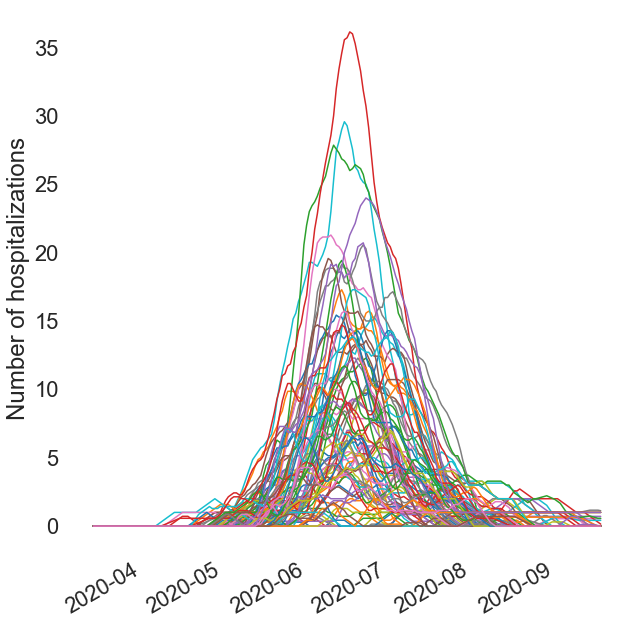

In [19]:
sim_ih = sim_arr.sel({'compartment': 'Ih'}).sum(dim=['risk_group', 'age_group'])
sim_rm = sim_ih.rolling(step=7, center=True).mean()
with sns.plotting_context("notebook", font_scale=2):
    sns.set_style('white')
    fig, ax = plt.subplots(1, 1, figsize=(10,10))
    sim_rm.plot(
        hue='vertex',
        x='step'
    )
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.get_legend().remove()
    ax.set_title('')
    ax.set_xlabel('')
    ax.set_ylabel('Number of hospitalizations')
    plt.savefig('/Users/kpierce/episimlab/demo_atx_ih_timeseries.png')
    plt.show()

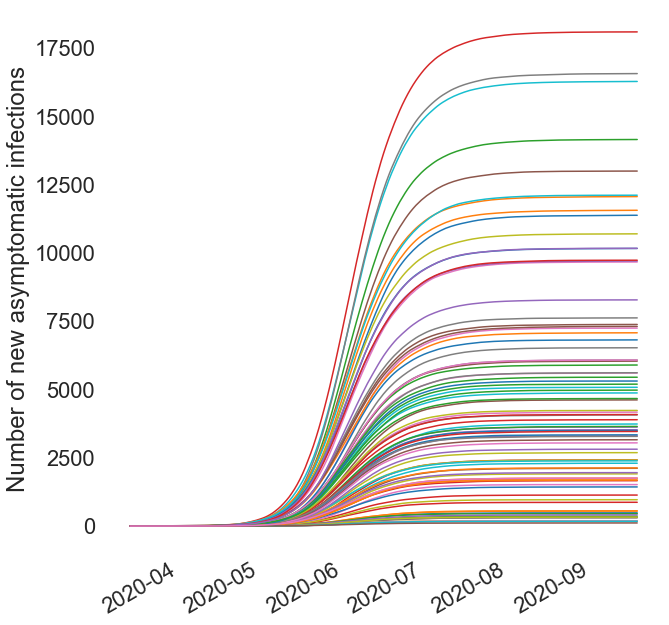

In [20]:
sim_ih = sim_arr.sel({'compartment': 'Pa2Ia'}).sum(dim=['risk_group', 'age_group'])
sim_rm = sim_ih.rolling(step=7, center=True).mean()
with sns.plotting_context("notebook", font_scale=2):
    sns.set_style('white')
    fig, ax = plt.subplots(1, 1, figsize=(10,10))
    sim_rm.plot(
        hue='vertex',
        x='step'
    )
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.get_legend().remove()
    ax.set_title('')
    ax.set_xlabel('')
    ax.set_ylabel('Number of new asymptomatic infections')
    plt.show()